In [1]:
import os
import sys
import json
import argparse

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import nibabel as nib
import seaborn as sns

from glob import glob
from nilearn.glm.second_level import SecondLevelModel
from nilearn.glm.second_level import make_second_level_design_matrix
from nilearn.image import threshold_img
from nilearn.glm import threshold_stats_img

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/nilearn/glm/__init__.py:55: FutureWarning: The nilearn.glm module is experimental. It may change in any future release of Nilearn.
  warn('The nilearn.glm module is experimental. '


In [2]:
from nilearn.masking import apply_mask
from scipy import stats

In [3]:
from nilearn import plotting, datasets, surface

# for plotting slices
mni152_template = datasets.load_mni152_template(resolution=1)
# for plotting on surface
fsaverage = datasets.fetch_surf_fsaverage('fsaverage')

In [4]:
task_label = 'tonecat'
contrast_label = 'resp'
fwhm = 0.00
space_label = 'MNI152NLin2009cAsym'

# define data directories
bidsroot = os.path.join('/bgfs/bchandrasekaran/krs228/data/', 
                        'FLT/',
                        'data_denoised', #'data_bids'
                       )
nilearn_dir = os.path.join(bidsroot, 'derivatives', 'nilearn')
masks_dir = os.path.join('/bgfs/bchandrasekaran/krs228/data/', 
                         'FLT/', 'data_bids', 'derivatives', 'nilearn', 'masks')
# define first-level directory where group-level inputs will be pulled from
l1_dir = os.path.join(nilearn_dir, 'level-1_fwhm-%.02f'%fwhm)

# create output directory
group_out_dir = os.path.join(nilearn_dir, 'group_fwhm-%.02f'%fwhm)
if not os.path.exists(group_out_dir):
        os.makedirs(group_out_dir)

Based on [nilearn documentation](https://nilearn.github.io/stable/auto_examples/05_glm_second_level/plot_thresholding.html#statistical-testing-of-a-second-level-analysis)

### Build the group-level design matrix

#### Read the `participants.tsv` file from the BIDS root directory

In [5]:
participants_fpath = os.path.join(bidsroot, 'participants.tsv')
participants_df = pd.read_csv(participants_fpath, sep='\t')

# subjects to ignore (not fully processed, etc.)
ignore_subs = ['sub-FLT27', # always leave out FLT27 – did not participate
               'sub-FLT07', # bad QA 11/14/23
               #'sub-FLT02', 'sub-FLT04', 'sub-FLT18', 'sub-FLT19', # currently reprocessing
              ]
participants_df.drop(participants_df[participants_df.participant_id.isin(ignore_subs)].index, inplace=True)

# re-sort by participant ID
participants_df.sort_values(by=['participant_id'], ignore_index=True, inplace=True)

In [6]:
print(participants_df)

   participant_id  age sex         group  FFR_id
0       sub-FLT02   21   F  non-Mandarin  1002.0
1       sub-FLT03   25   F      Mandarin  2002.0
2       sub-FLT04   21   F  non-Mandarin  1003.0
3       sub-FLT05   26   M      Mandarin  3010.0
4       sub-FLT06   21   F  non-Mandarin  3001.0
5       sub-FLT08   23   F      Mandarin  2005.0
6       sub-FLT09   30   F  non-Mandarin  3002.0
7       sub-FLT10   23   F      Mandarin  2006.0
8       sub-FLT11   20   F  non-Mandarin  1005.0
9       sub-FLT12   20   F  non-Mandarin  3004.0
10      sub-FLT13   23   F  non-Mandarin  3005.0
11      sub-FLT14   23   M  non-Mandarin  3006.0
12      sub-FLT15   22   M      Mandarin  2010.0
13      sub-FLT17   29   F      Mandarin     NaN
14      sub-FLT18   24   M      Mandarin  2016.0
15      sub-FLT19   24   M      Mandarin  2018.0
16      sub-FLT20   26   F  non-Mandarin  3008.0
17      sub-FLT21   21   M      Mandarin  2011.0
18      sub-FLT22   41   F      Mandarin  2017.0
19      sub-FLT23   

In [7]:
# create group-specific lists of subject IDs
sub_list_mand = list(participants_df.participant_id[participants_df.group=='Mandarin'])
sub_list_nman = list(participants_df.participant_id[participants_df.group=='non-Mandarin'])

In [8]:
print(sub_list_mand)

['sub-FLT03', 'sub-FLT05', 'sub-FLT08', 'sub-FLT10', 'sub-FLT15', 'sub-FLT17', 'sub-FLT18', 'sub-FLT19', 'sub-FLT21', 'sub-FLT22', 'sub-FLT23', 'sub-FLT24', 'sub-FLT26']


In [9]:
print(sub_list_nman)

['sub-FLT02', 'sub-FLT04', 'sub-FLT06', 'sub-FLT09', 'sub-FLT11', 'sub-FLT12', 'sub-FLT13', 'sub-FLT14', 'sub-FLT20', 'sub-FLT25', 'sub-FLT28', 'sub-FLT30']


#### Create design matrixes

In [10]:
# get participant IDs and their group labels
subjects_label = list(participants_df.participant_id)
groups_label = list(participants_df.group)

# make new dataframe from the group labels
design_mat_groupdiff = pd.DataFrame({'Mand': groups_label,
                                     'NMan': groups_label,
                                    }
                                   )
# convert to 1s and 0s for each group as appropriate
design_mat_groupdiff['Mand'].loc[design_mat_groupdiff['Mand'] == 'Mandarin'] = 1
design_mat_groupdiff['Mand'].loc[design_mat_groupdiff['Mand'] == 'non-Mandarin'] = 0
design_mat_groupdiff['NMan'].loc[design_mat_groupdiff['NMan'] == 'Mandarin'] = 0
design_mat_groupdiff['NMan'].loc[design_mat_groupdiff['NMan'] == 'non-Mandarin'] = 1
design_mat_groupdiff = design_mat_groupdiff.astype('int')
print(design_mat_groupdiff)

    Mand  NMan
0      0     1
1      1     0
2      0     1
3      1     0
4      0     1
5      1     0
6      0     1
7      1     0
8      0     1
9      0     1
10     0     1
11     0     1
12     1     0
13     1     0
14     1     0
15     1     0
16     0     1
17     1     0
18     1     0
19     1     0
20     1     0
21     0     1
22     1     0
23     0     1
24     0     1


### Define regions

In [13]:
## define ROIs
network_name = 'tian_subcortical_S3' # 'tian_subcortical_S3' # auditory

if network_name == 'auditory':
    roi_list_ordered = [
                'L-IC', 'L-MGN', 'L-HG', 'L-PT',  'L-PP', 'L-STGp', 'L-STGa', 'L-ParsOp', 'L-ParsTri',
                'R-IC', 'R-MGN', 'R-HG', 'R-PT',  'R-PP', 'R-STGp', 'R-STGa', 'R-ParsOp', 'R-ParsTri', 
               ]
elif network_name == 'aud-striatal':
    roi_list_ordered = ['L-Caud', 'L-Put', 'L-IC', 'L-MGN',
                'L-HG', 'L-PP', 'L-PT', 'L-STGa', 'L-STGp', 
                'L-ParsOp', 'L-ParsTri',
                'R-Caud', 'R-Put','R-IC', 'R-MGN',
                'R-HG', 'R-PP', 'R-PT', 'R-STGa', 'R-STGp', 
                'R-ParsOp', 'R-ParsTri',
               ]
elif network_name == 'tian_subcortical_S3':
    roi_list_ordered = [
        'CAU-DA-lh', 'CAU-DA-rh', 
        'CAU-VA-lh', 'CAU-VA-rh', 
        'pCAU-lh', 'pCAU-rh', 
        'PUT-DA-lh', 'PUT-DA-rh', 
        'PUT-DP-lh', 'PUT-DP-rh', 
        'PUT-VA-lh', 'PUT-VA-rh', 
        'PUT-VP-lh', 'PUT-VP-rh',
        'NAc-core-lh',  'NAc-core-rh', 
        'NAc-shell-lh', 'NAc-shell-rh', 
         #'aGP-lh', 'pGP-lh', 
         #'aGP-rh', 'pGP-rh',         
               ]
    
region_list = roi_list_ordered

In [14]:
print(region_list)

['CAU-DA-lh', 'CAU-DA-rh', 'CAU-VA-lh', 'CAU-VA-rh', 'pCAU-lh', 'pCAU-rh', 'PUT-DA-lh', 'PUT-DA-rh', 'PUT-DP-lh', 'PUT-DP-rh', 'PUT-VA-lh', 'PUT-VA-rh', 'PUT-VP-lh', 'PUT-VP-rh', 'NAc-core-lh', 'NAc-core-rh', 'NAc-shell-lh', 'NAc-shell-rh']


# Across all runs

### Get files

In [15]:
# get the beta map for the contrast of interest for each subject
l1_fnames_groupdiff = [sorted(glob(l1_dir+f'/{sub_id}_space-{space_label}/run-all_LSS/*contrast-{contrast_label}_model-LSS_map-beta.nii.gz'))[0] for sub_id in subjects_label]

In [16]:
l1_fnames_mand = [sorted(glob(l1_dir+f'/{sub_id}_space-{space_label}/run-all_LSS/*contrast-{contrast_label}_model-LSS_map-beta.nii.gz'))[0] for sub_id in sub_list_mand]
l1_fnames_nman = [sorted(glob(l1_dir+f'/{sub_id}_space-{space_label}/run-all_LSS/*contrast-{contrast_label}_model-LSS_map-beta.nii.gz'))[0] for sub_id in sub_list_nman]

## Mask stat maps

In [17]:
roi_mean_dict = {}
for rx, region in enumerate(region_list):
    print(region)
    roi_mean_list = []
    
    for fx, stat_fpath in enumerate(l1_fnames_groupdiff):
        sub_id = subjects_label[fx]
        mask_fpath = glob(masks_dir + f'/{sub_id}/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz')[0]
        
        masked_data = apply_mask(stat_fpath, mask_fpath)
        roi_mean_sub = masked_data.mean()
        
        roi_mean_list.append(roi_mean_sub)
        
    roi_mean_dict[region] = roi_mean_list

CAU-DA-lh
CAU-DA-rh
CAU-VA-lh
CAU-VA-rh
pCAU-lh
pCAU-rh
PUT-DA-lh
PUT-DA-rh
PUT-DP-lh
PUT-DP-rh
PUT-VA-lh
PUT-VA-rh
PUT-VP-lh
PUT-VP-rh
NAc-core-lh
NAc-core-rh
NAc-shell-lh
NAc-shell-rh


In [18]:
roi_df = pd.DataFrame.from_dict(roi_mean_dict)

roi_df['participant_id'] = participants_df.participant_id
roi_df['participant_group'] = participants_df.group

In [19]:
roi_df_long = roi_df.melt(id_vars=["participant_id", "participant_group"], 
                          var_name="region", value_name="beta")

In [20]:
roi_df_long

,participant_id,participant_group,region,beta
0,sub-FLT02,non-Mandarin,CAU-DA-lh,0.895301
1,sub-FLT03,Mandarin,CAU-DA-lh,2.475523
2,sub-FLT04,non-Mandarin,CAU-DA-lh,-0.139771
3,sub-FLT05,Mandarin,CAU-DA-lh,2.361229
4,sub-FLT06,non-Mandarin,CAU-DA-lh,2.790089
...,...,...,...,...
445,sub-FLT24,Mandarin,NAc-shell-rh,2.283832
446,sub-FLT25,non-Mandarin,NAc-shell-rh,1.779726
447,sub-FLT26,Mandarin,NAc-shell-rh,1.177414
448,sub-FLT28,non-Mandarin,NAc-shell-rh,2.453157


### split hemisphere into its own column

In [21]:
if network_name == 'auditory':
    roi_df_long['hemisphere'] = roi_df_long.region.str[0]
    roi_df_long['region'] = roi_df_long.region.str[2:]
elif network_name == 'tian_subcortical_S3':
    roi_df_long['hemisphere'] = roi_df_long.region.str[-2:]
    roi_df_long['region'] = roi_df_long.region.str[:-3]

In [22]:
roi_df_long

,participant_id,participant_group,region,beta,hemisphere
0,sub-FLT02,non-Mandarin,CAU-DA,0.895301,lh
1,sub-FLT03,Mandarin,CAU-DA,2.475523,lh
2,sub-FLT04,non-Mandarin,CAU-DA,-0.139771,lh
3,sub-FLT05,Mandarin,CAU-DA,2.361229,lh
4,sub-FLT06,non-Mandarin,CAU-DA,2.790089,lh
...,...,...,...,...,...
445,sub-FLT24,Mandarin,NAc-shell,2.283832,rh
446,sub-FLT25,non-Mandarin,NAc-shell,1.779726,rh
447,sub-FLT26,Mandarin,NAc-shell,1.177414,rh
448,sub-FLT28,non-Mandarin,NAc-shell,2.453157,rh


### Plot ROI boxplots

#### Non-Mandarin speaking group

/scratch/slurm-3204847/ipykernel_6102/702406540.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/scratch/slurm-3204847/ipykernel_6102/702406540.py:4: UserWarning:


The palette list has fewer values (1) than needed (9) and will cycle, which may produce an uninterpretable plot.

/scratch/slurm-3204847/ipykernel_6102/702406540.py:13: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/scratch/slurm-3204847/ipykernel_6102/702406540.py:13: UserWarning:


The palette list has fewer values (1) than needed (9) and will cycle, which may produce an uninterpretable plot.

/scratch/slurm-3204847/ipykernel_6102/702406540.py:24: UserWarning:

FixedFormatter should only be used together with FixedLocator



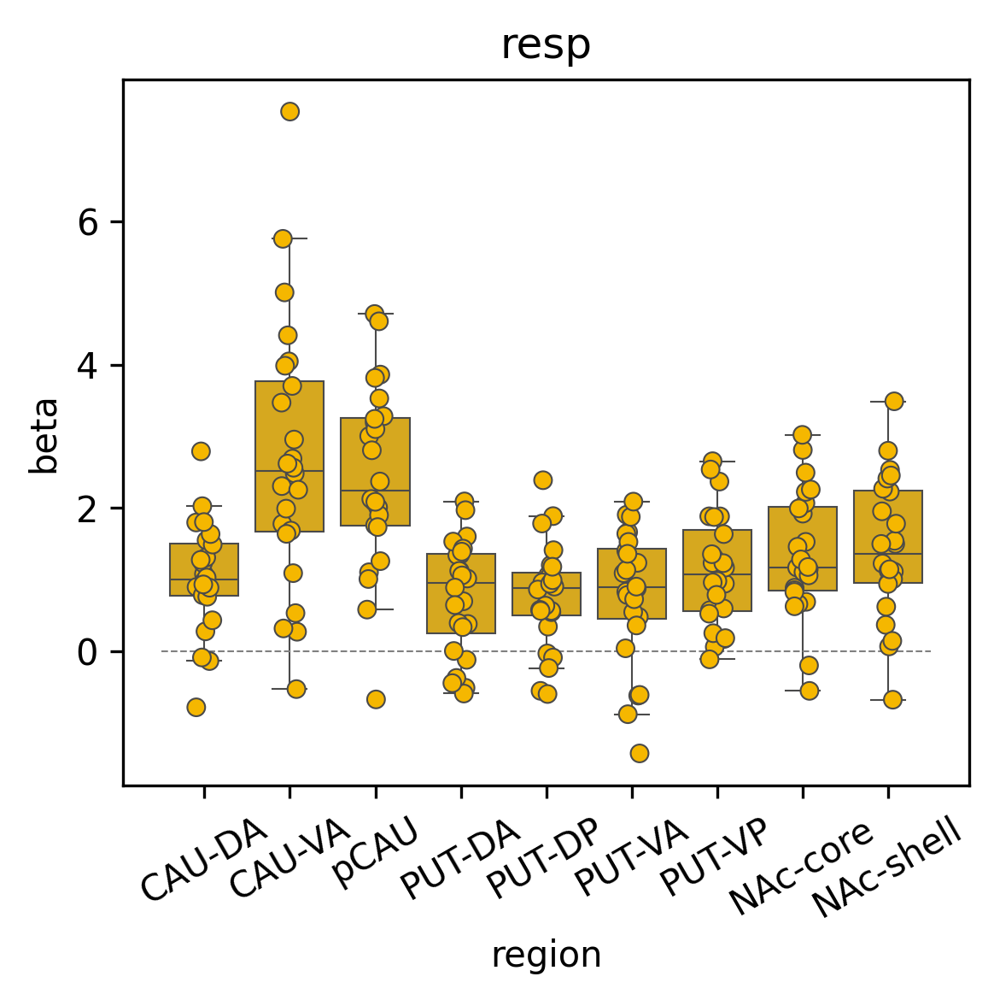

In [34]:
fig, ax = plt.subplots(1, 1, figsize=(4,4), dpi=300)
#yrange = [-3, 3]

sns.boxplot(data=roi_df_long.where(roi_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              #hue='hemisphere',
              #palette=['#fdb863','#b2abd2'],
              palette=['#F5B700'],
              linewidth=0.5,
              fliersize = 0,
              legend=None,
              ax=ax);
sns.stripplot(data=roi_df_long.where(roi_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              #hue='hemisphere',
              #palette=['#e66101','#5e3c99'],
              #dodge=True,
              palette=['#F5B700'],
              linewidth=0.5,
              ax=ax);
xmin, xmax = ax.get_xlim()
ax.hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
#ax.set_ylim(yrange)
ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='center')
#sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
ax.set_title(f'{contrast_label}');

'''
# OUT OF DATE
# MANUAL SIGNIFICANCE MARKS (see statistics above – not ordered the same as here)
plt.text(3 -0.25, 3, '*')
plt.text(5 -0.25, 3, '*')
plt.text(10-0.25, 3, '*')
plt.text(5 +0.25, 3, '*')
'''
fig.tight_layout()


#### Compare groups

In [ ]:
fig, ax = plt.subplots(2, 1, figsize=(8,6), dpi=300)
yrange = [-10, 20]
sns.boxplot(data=roi_df_long.where(roi_df_long.participant_group=='Mandarin'), 
              x='region', y='beta', 
              hue='hemisphere',
              palette=['#fdb863','#b2abd2'],
              linewidth=0.5,
              ax=ax[0]);
sns.stripplot(data=roi_df_long.where(roi_df_long.participant_group=='Mandarin'), 
              x='region', y='beta', 
              hue='hemisphere',
              palette=['#e66101','#5e3c99'],
              dodge=True,
              linewidth=0.5,
              ax=ax[0]);
xmin, xmax = ax[0].get_xlim()
ax[0].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
ax[0].set_ylim(yrange)
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=30, ha='center')
sns.move_legend(ax[0], "upper left", bbox_to_anchor=(1, 1))
ax[0].set_title('Native Mandarin speakers');

sns.boxplot(data=roi_df_long.where(roi_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              hue='hemisphere',
              palette=['#fdb863','#b2abd2'],
              linewidth=0.5,
              ax=ax[1]);
sns.stripplot(data=roi_df_long.where(roi_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              hue='hemisphere',
              palette=['#e66101','#5e3c99'],
              dodge=True,
              linewidth=0.5,
              ax=ax[1]);
xmin, xmax = ax[1].get_xlim()
ax[1].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
ax[1].set_ylim(yrange)
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=30, ha='center')
sns.move_legend(ax[1], "upper left", bbox_to_anchor=(1, 1))
ax[1].set_title('Non-Mandarin speakers');

fig.tight_layout()


#### all participants

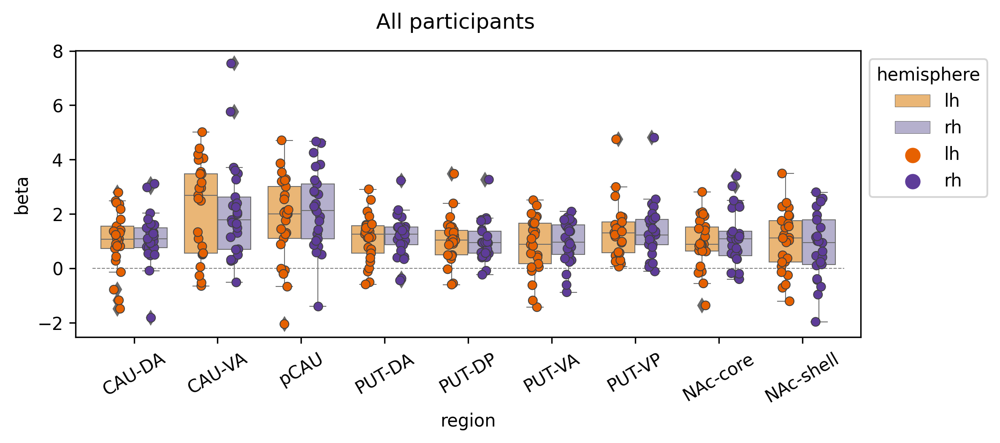

In [22]:
fig, ax = plt.subplots(figsize=(8,3), dpi=300)
sns.boxplot(data=roi_df_long, 
              x='region', y='beta', 
              hue='hemisphere',
              palette=['#fdb863','#b2abd2'],
              #dodge=True,
              linewidth=0.5,
              ax=ax);
sns.stripplot(data=roi_df_long, 
              x='region', y='beta', 
              hue='hemisphere',
              palette=['#e66101','#5e3c99'],
              dodge=True,
              linewidth=0.5,
              ax=ax);
fig.suptitle('All participants')
ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='center')
ax.hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

### Statistics

#### Within group, combining hemispheres

In [25]:
group = 'non-Mandarin'
#for group in np.unique(roi_df.participant_group):
p_vals = []
t_stats = []
print(f'\ngroup = {group}')
print('\nFDR-adjusted statistics')
for roi in np.unique(roi_df_long.region):
    groi_data = roi_df_long.where(roi_df_long.region==roi).dropna().beta
    res = stats.ttest_1samp(groi_data, popmean=0)
    #print(f't = {res.statistic:.02f} p = {res.pvalue:.04f} region = {roi}')
    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
p_vals_adj = stats.false_discovery_control(p_vals)
for rx, roi in enumerate(np.unique(roi_df_long.region)):
    if p_vals_adj[rx] < 0.05:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')


group = non-Mandarin

FDR-adjusted statistics
**t = 7.43 FDR-corr p = 0.0000 uncorr p = 0.0000 region = CAU-DA
**t = 8.77 FDR-corr p = 0.0000 uncorr p = 0.0000 region = CAU-VA
**t = 7.54 FDR-corr p = 0.0000 uncorr p = 0.0000 region = NAc-core
**t = 5.49 FDR-corr p = 0.0000 uncorr p = 0.0000 region = NAc-shell
**t = 9.81 FDR-corr p = 0.0000 uncorr p = 0.0000 region = PUT-DA
**t = 9.13 FDR-corr p = 0.0000 uncorr p = 0.0000 region = PUT-DP
**t = 7.02 FDR-corr p = 0.0000 uncorr p = 0.0000 region = PUT-VA
**t = 9.43 FDR-corr p = 0.0000 uncorr p = 0.0000 region = PUT-VP
**t = 9.32 FDR-corr p = 0.0000 uncorr p = 0.0000 region = pCAU


#### Group differences

In [23]:
p_vals = []
t_stats = []
print('\nGroup differences (Mandarin > non-Mandarin)')
for roi in region_list:
    mand_data = roi_df.where(roi_df.participant_group=='Mandarin').dropna()[roi]
    nman_data = roi_df.where(roi_df.participant_group=='non-Mandarin').dropna()[roi]
    res = stats.ttest_ind(mand_data, nman_data)
    #print(f'p = {res.pvalue:.04f} t = {res.statistic:.02f} region = {roi}')
    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
p_vals_adj = stats.false_discovery_control(p_vals)

print('\nFDR-adjusted statistics')
for rx, roi in enumerate(region_list):
    print(f't = {t_stats[rx]:.02f} p = {p_vals_adj[rx]:.04f} region = {roi}')


Group differences (Mandarin > non-Mandarin)

FDR-adjusted statistics
t = 0.44 p = 0.7049 region = CAU-DA-lh
t = -1.47 p = 0.2469 region = CAU-VA-lh
t = -2.04 p = 0.1905 region = pCAU-lh
t = 2.34 p = 0.1712 region = PUT-DA-lh
t = 1.49 p = 0.2469 region = PUT-DP-lh
t = 0.47 p = 0.7049 region = PUT-VA-lh
t = 1.50 p = 0.2469 region = PUT-VP-lh
t = -1.82 p = 0.2460 region = NAc-core-lh
t = -2.55 p = 0.1712 region = NAc-shell-lh
t = -0.22 p = 0.8278 region = CAU-DA-rh
t = -1.56 p = 0.2469 region = CAU-VA-rh
t = -0.90 p = 0.5168 region = pCAU-rh
t = 2.38 p = 0.1712 region = PUT-DA-rh
t = 1.68 p = 0.2469 region = PUT-DP-rh
t = 0.85 p = 0.5168 region = PUT-VA-rh
t = 0.65 p = 0.6271 region = PUT-VP-rh
t = -1.44 p = 0.2469 region = NAc-core-rh
t = -2.18 p = 0.1803 region = NAc-shell-rh


#### Within-group significance

In [26]:
group = 'non-Mandarin'
#for group in np.unique(roi_df.participant_group):
p_vals = []
t_stats = []
print(f'\ngroup = {group}')
print('\nFDR-adjusted statistics')
for roi in region_list:
    groi_data = roi_df.where(roi_df.participant_group==group).dropna()[roi]
    res = stats.ttest_1samp(groi_data, popmean=0)
    #print(f't = {res.statistic:.02f} p = {res.pvalue:.04f} region = {roi}')
    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
p_vals_adj = stats.false_discovery_control(p_vals)
for rx, roi in enumerate(region_list):
    if p_vals_adj[rx] < 0.05:
        ast = '*'
    else:
        ast = ' '
    print(f'{ast}t = {t_stats[rx]:.02f} p = {p_vals_adj[rx]:.04f} region = {roi}')


group = non-Mandarin

FDR-adjusted statistics
*t = 3.39 p = 0.0077 region = CAU-DA-lh
*t = 7.04 p = 0.0002 region = CAU-DA-rh
*t = 5.70 p = 0.0006 region = CAU-VA-lh
*t = 4.35 p = 0.0017 region = CAU-VA-rh
*t = 5.73 p = 0.0006 region = pCAU-lh
*t = 7.42 p = 0.0002 region = pCAU-rh
*t = 2.81 p = 0.0180 region = PUT-DA-lh
*t = 3.81 p = 0.0040 region = PUT-DA-rh
*t = 3.06 p = 0.0122 region = PUT-DP-lh
*t = 4.46 p = 0.0016 region = PUT-DP-rh
*t = 2.63 p = 0.0234 region = PUT-VA-lh
*t = 3.15 p = 0.0111 region = PUT-VA-rh
*t = 4.54 p = 0.0016 region = PUT-VP-lh
*t = 5.17 p = 0.0008 region = PUT-VP-rh
*t = 5.10 p = 0.0008 region = NAc-core-lh
*t = 5.41 p = 0.0006 region = NAc-core-rh
*t = 5.56 p = 0.0006 region = NAc-shell-lh
*t = 4.52 p = 0.0016 region = NAc-shell-rh


#### all participants

In [25]:
p_vals = []
t_stats = []
print(f'group = all')
for roi in region_list:
    groi_data = roi_df.dropna()[roi]
    res = stats.ttest_1samp(groi_data, popmean=0)
    #print(f't = {res.statistic:.02f} p = {res.pvalue:.04f} region = {roi}')
    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
    
# uncorrected stats
print('\nuncorrected statistics')
for rx, roi in enumerate(region_list):
    if p_vals[rx] < 0.01:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} p = {p_vals[rx]:05f} region = {roi}')
    
# FDR-corrected stats
p_vals_adj = stats.false_discovery_control(p_vals)
print('\nFDR-adjusted statistics')
for rx, roi in enumerate(region_list):
    if p_vals_adj[rx] < 0.01:
        ast = '**'
    elif p_vals_adj[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} p = {p_vals_adj[rx]:.05f} region = {roi}')


group = all

uncorrected statistics
**t = 4.64 p = 0.000104 region = CAU-DA-lh
**t = 6.47 p = 0.000001 region = CAU-VA-lh
**t = 5.75 p = 0.000006 region = pCAU-lh
**t = 6.28 p = 0.000002 region = PUT-DA-lh
**t = 6.13 p = 0.000003 region = PUT-DP-lh
**t = 4.16 p = 0.000348 region = PUT-VA-lh
**t = 6.56 p = 0.000001 region = PUT-VP-lh
**t = 5.15 p = 0.000029 region = NAc-core-lh
**t = 4.34 p = 0.000220 region = NAc-shell-lh
**t = 5.90 p = 0.000004 region = CAU-DA-rh
**t = 5.83 p = 0.000005 region = CAU-VA-rh
**t = 7.47 p = 0.000000 region = pCAU-rh
**t = 7.56 p = 0.000000 region = PUT-DA-rh
**t = 6.76 p = 0.000001 region = PUT-DP-rh
**t = 5.99 p = 0.000004 region = PUT-VA-rh
**t = 6.63 p = 0.000001 region = PUT-VP-rh
**t = 5.45 p = 0.000013 region = NAc-core-rh
**t = 3.39 p = 0.002392 region = NAc-shell-rh

FDR-adjusted statistics
**t = 4.64 p = 0.00012 region = CAU-DA-lh
**t = 6.47 p = 0.00000 region = CAU-VA-lh
**t = 5.75 p = 0.00001 region = pCAU-lh
**t = 6.28 p = 0.00000 region = PUT

### Plot on brain

CAU-DA-lh
CAU-DA-rh
CAU-VA-lh
CAU-VA-rh
pCAU-lh
pCAU-rh
PUT-DA-lh
PUT-DA-rh
PUT-DP-lh
PUT-DP-rh
PUT-VA-lh
PUT-VA-rh
PUT-VP-lh
PUT-VP-rh
NAc-core-lh
NAc-core-rh
NAc-shell-lh
NAc-shell-rh


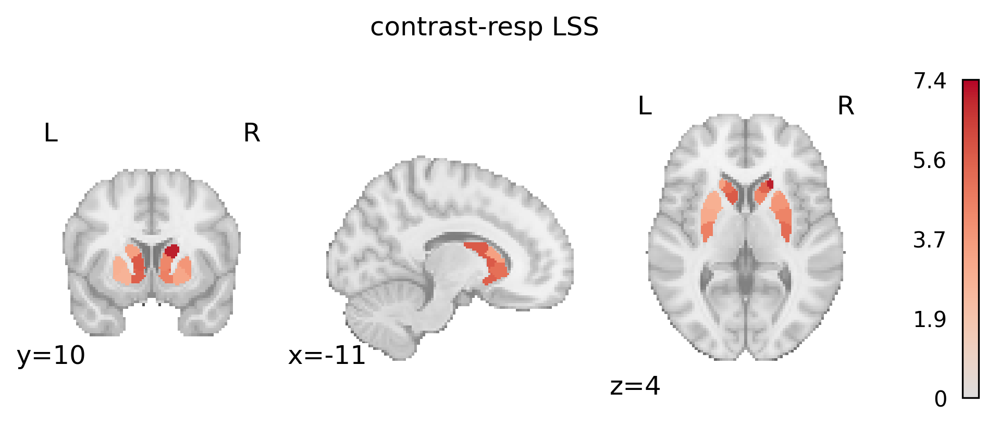

In [33]:
from nilearn.image import new_img_like
from nilearn import plotting

mask_path_list = []
for rx, region in enumerate(region_list):
    print(region)
    
    sub_id = subjects_label[fx]
    mask_fpath = glob(masks_dir + f'/{sub_id}/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz')[0]

    # create list of mask file paths
    mask_path_list.append(mask_fpath)

roi_stat_data_list = []
for rx, rpath in enumerate(mask_path_list):
    roi_img = nib.load(rpath)
    roi_data = roi_img.get_fdata()
    
    roi_stat = t_stats[rx]
    roi_stat_data = roi_data * roi_stat
    
    roi_stat_data_list.append(roi_stat_data)

# add maps together and make nifti img
roi_stat_map_data = sum(roi_stat_data_list)
roi_stat_map_img = new_img_like(roi_img, roi_stat_map_data)

title = f'contrast-{contrast_label} LSS'
fig, ax = plt.subplots(figsize=(8,3), dpi=300)
plotting.plot_stat_map(roi_stat_map_img,
                       cmap='coolwarm',
                       draw_cross=False,
                       axes=ax)
fig.suptitle(title);

### 3D interactive plots

In [1]:
group_label = 'NMan'

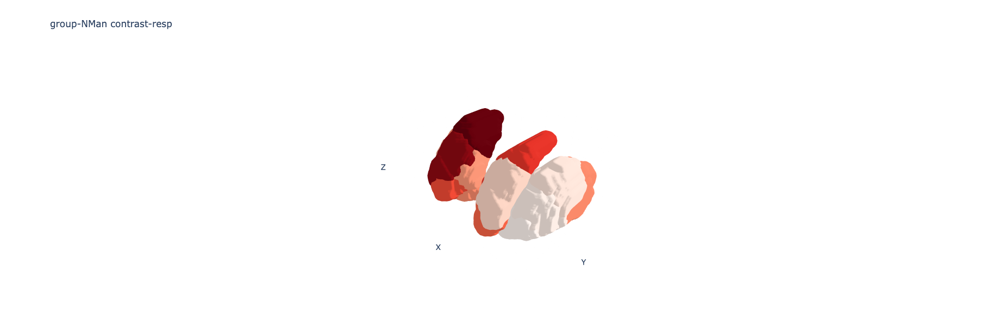

In [31]:
import numpy as np
import nibabel as nib
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from matplotlib import cm
from skimage import measure
from scipy.ndimage import gaussian_filter

# Load NIfTI files into a list
nifti_files = mask_path_list

# Define a colormap
colormap = cm.get_cmap('Reds')

# Define the list of values for color plotting
color_values = t_stats  # Adjust these values as needed

# Create a list to hold the data for each segmentation
segmentations = []

# Loop through each NIfTI file and extract segmentation data
for nifti_file in nifti_files:
    nifti_data = nib.load(nifti_file)
    segmentation = nifti_data.get_fdata()
    segmentations.append(segmentation)

# Combine all segmentations into a single binary mask
combined_segmentation = np.any(segmentations, axis=0)

# Upsample the voxel data to a higher resolution grid
upsampled_segmentation = np.repeat(np.repeat(np.repeat(combined_segmentation, 2, axis=0), 2, axis=1), 2, axis=2)

# Smooth the upsampled voxel data with a Gaussian filter
smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)

# Extract the surface mesh of the smoothed segmented region with adjusted level
vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())

# Translate vertices closer to the origin
center = vertices.mean(axis=0)
vertices -= center

# Create a subplot for the 3D plot with a larger size
fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'mesh3d'}]], print_grid=False)

# Loop through each segmentation and add its surface plot to the subplot
for i, segmentation in enumerate(segmentations):
    # Upsample the voxel data to a higher resolution grid
    upsampled_segmentation = np.repeat(np.repeat(np.repeat(segmentation, 2, axis=0), 2, axis=1), 2, axis=2)
    
    # Smooth the upsampled voxel data with a Gaussian filter
    smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)
    
    # Extract the surface mesh of the smoothed segmented region with adjusted level
    vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())
    
    vertices -= center
    
    # Map the color value to the colormap
    colormap_value = (color_values[i] - min(color_values)) / (max(color_values) - min(color_values))
    color = colormap(colormap_value)
    
    # Add the surface plot to the subplot
    fig.add_trace(go.Mesh3d(
        x=vertices[:, 0],
        y=vertices[:, 1],
        z=vertices[:, 2],
        i=faces[:, 0],
        j=faces[:, 1],
        k=faces[:, 2],
        color=f'rgb({int(color[0]*255)}, {int(color[1]*255)}, {int(color[2]*255)})',
        opacity=1,
        name= region_list[i] # f'Segmentation {i+1}'
    ))
    
    # DOES NOT APPEAR TO WORK
    '''
    # Add annotation for the region value
    region_value = color_values[i]
    fig.add_annotation(
        x=vertices[:, 0].mean(),
        y=vertices[:, 1].mean(),
        text=f'Region Value: {region_value:.2f}',
        showarrow=False,
        font=dict(color='white', size=12)
    )
    '''
# Set starting camera angle
camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=-1.25, y=1.25, z=1.25)
)

# Update layout for the 3D plot to set a larger size and transparent background
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        yaxis=dict(title='Y', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        zaxis=dict(title='Z', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        bgcolor='rgba(0,0,0,0)',  # Set background color to transparent
        camera=camera  # Set starting camera angle
    ),
    title=f'group-{group_label} contrast-{contrast_label}',
    width=800,  # Set width of the plot
    height=600,  # Set height of the plot
)


# Show the interactive plot
fig.show()

# Save the interactive plot as an SVG file
fig.write_image(f'out-figure_group-{group_label}_contrast-{contrast_label}_model-LSS_surface.svg')

#### Make a plot of just the ROIs

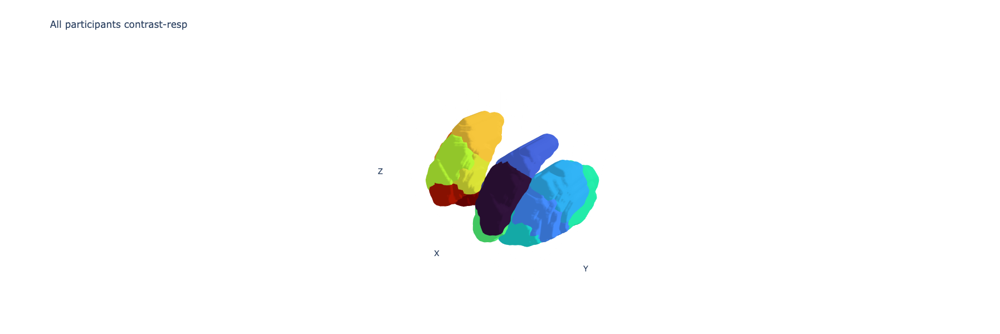

In [37]:
import numpy as np
import nibabel as nib
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from matplotlib import cm
from skimage import measure
from scipy.ndimage import gaussian_filter

# Load NIfTI files into a list
nifti_files = mask_path_list

# Define a colormap
colormap = cm.get_cmap('turbo')

# Define the list of values for color plotting
color_values = [x+1 for x in range(len(t_stats))] #t_stats  # Adjust these values as needed

# Create a list to hold the data for each segmentation
segmentations = []

# Loop through each NIfTI file and extract segmentation data
for nifti_file in nifti_files:
    nifti_data = nib.load(nifti_file)
    segmentation = nifti_data.get_fdata()
    segmentations.append(segmentation)

# Combine all segmentations into a single binary mask
combined_segmentation = np.any(segmentations, axis=0)

# Upsample the voxel data to a higher resolution grid
upsampled_segmentation = np.repeat(np.repeat(np.repeat(combined_segmentation, 2, axis=0), 2, axis=1), 2, axis=2)

# Smooth the upsampled voxel data with a Gaussian filter
smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)

# Extract the surface mesh of the smoothed segmented region with adjusted level
vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())

# Translate vertices closer to the origin
center = vertices.mean(axis=0)
vertices -= center

# Create a subplot for the 3D plot with a larger size
fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'mesh3d'}]], print_grid=False)

# Loop through each segmentation and add its surface plot to the subplot
for i, segmentation in enumerate(segmentations):
    # Upsample the voxel data to a higher resolution grid
    upsampled_segmentation = np.repeat(np.repeat(np.repeat(segmentation, 2, axis=0), 2, axis=1), 2, axis=2)
    
    # Smooth the upsampled voxel data with a Gaussian filter
    smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)
    
    # Extract the surface mesh of the smoothed segmented region with adjusted level
    vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())
    
    vertices -= center
    
    # Map the color value to the colormap
    colormap_value = (color_values[i] - min(color_values)) / (max(color_values) - min(color_values))
    color = colormap(colormap_value)
    
    # Add the surface plot to the subplot
    fig.add_trace(go.Mesh3d(
        x=vertices[:, 0],
        y=vertices[:, 1],
        z=vertices[:, 2],
        i=faces[:, 0],
        j=faces[:, 1],
        k=faces[:, 2],
        color=f'rgb({int(color[0]*255)}, {int(color[1]*255)}, {int(color[2]*255)})',
        opacity=1,
        name= region_list[i] # f'Segmentation {i+1}'
    ))
    
    # DOES NOT APPEAR TO WORK
    '''
    # Add annotation for the region value
    region_value = color_values[i]
    fig.add_annotation(
        x=vertices[:, 0].mean(),
        y=vertices[:, 1].mean(),
        text=f'Region Value: {region_value:.2f}',
        showarrow=False,
        font=dict(color='white', size=12)
    )
    '''
# Set starting camera angle
camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=-1.25, y=1.25, z=1.25)
)

# Update layout for the 3D plot to set a larger size and transparent background
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        yaxis=dict(title='Y', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        zaxis=dict(title='Z', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        bgcolor='rgba(0,0,0,0)',  # Set background color to transparent
        camera=camera  # Set starting camera angle
    ),
    title=f'All participants contrast-{contrast_label}',
    width=800,  # Set width of the plot
    height=600,  # Set height of the plot
)


# Show the interactive plot
fig.show()

# Save the interactive plot as an SVG file
#fig.write_image(f'out-figure_group-all_contrast-{contrast_label}_model-LSS_surface.svg')